# Prepare the dataset 
Consists of images and labels. The labels have ground truth masks (annotated images).

In [1]:
import os
import random
from torch.utils.data import Dataset, DataLoader, random_split
from PIL import Image
import torchvision.transforms as transforms

class RockArtDataset(Dataset):
    def __init__(self, images_dir, labels_dir, transform=None):
        self.images_dir = images_dir
        self.labels_dir = labels_dir
        self.image_filenames = os.listdir(images_dir)  
        self.transform = transform

    def __len__(self):
        return len(self.image_filenames)

    def __getitem__(self, idx):
        image_name = self.image_filenames[idx]
        image_path = os.path.join(self.images_dir, image_name)
        label_path = os.path.join(self.labels_dir, image_name)  

        image = Image.open(image_path).convert('RGB')  
        label = Image.open(label_path).convert('L')  #label to grayscale

        if self.transform:
            image = self.transform(image)
            label = self.transform(label)

        return image, label

transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(), 
])


images_dir = '/kaggle/input/rockart/rockart/images'  
labels_dir = '/kaggle/input/rockart/rockart/labels'  

full_dataset = RockArtDataset(images_dir=images_dir, labels_dir=labels_dir, transform=transform)

# split the dataset into train and validation (80% train, 20% validation)
train_size = int(0.8 * len(full_dataset)) 
val_size = len(full_dataset) - train_size

train_dataset, val_dataset = random_split(full_dataset, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=False)


# Load the DeepLabV3(ResNet - 101 variant) Model

In [5]:
import torch
import torchvision.models.segmentation as segmentation

#load the pre-trained deeplabv3 model (ResNet-101)
model = segmentation.deeplabv3_resnet101(weights=True)

#two classes foreground and background
num_classes = 2 
model.classifier[4] = torch.nn.Conv2d(256, num_classes, kernel_size=1)  #replace final layer


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DeepLabV3_ResNet101_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=DeepLabV3_ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


**Fine tune the pre-trained model on the available rock art dataset**

In [6]:
import torch.optim as optim
criterion = torch.nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-4)

In [7]:
from sklearn.metrics import jaccard_score

num_epochs = 10
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

def compute_iou(preds, labels):
    preds = preds.view(-1)
    labels = labels.view(-1)
    return jaccard_score(labels.cpu().numpy(), preds.cpu().numpy(), average='binary')

def compute_dice(preds, labels, smooth=1e-6):
    preds = preds.view(-1)
    labels = labels.view(-1)
    intersection = (preds * labels).sum()
    return (2. * intersection + smooth) / (preds.sum() + labels.sum() + smooth)

for epoch in range(num_epochs):
    model.train()
    train_loss = 0.0

    for inputs, labels in train_loader:
        inputs = inputs.to(device)
        labels = labels.to(device).squeeze(1).long()

        optimizer.zero_grad()
        outputs = model(inputs)['out']
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        train_loss += loss.item()

    avg_train_loss = train_loss / len(train_loader)

    #validation
    model.eval()
    val_loss = 0.0
    total_iou = 0.0
    total_dice = 0.0
    num_batches = 0

    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs = inputs.to(device)
            labels = labels.to(device).squeeze(1).long()

            outputs = model(inputs)['out']
            loss = criterion(outputs, labels)
            val_loss += loss.item()

            preds = torch.argmax(outputs, dim=1)

            total_iou += compute_iou(preds, labels)
            total_dice += compute_dice(preds.float(), labels.float())
            num_batches += 1

    avg_val_loss = val_loss / len(val_loader)
    avg_iou = total_iou / num_batches
    avg_dice = total_dice / num_batches
    combined_loss = ((avg_iou + avg_dice) / 2)  

    print(f"Epoch {epoch+1}/{num_epochs} | "
          f"Train Loss: {avg_train_loss:.4f} | "
          f"Val Loss: {avg_val_loss:.4f} | "
          f"Val IoU: {avg_iou:.4f} | "
          f"Val Dice: {avg_dice:.4f} | "
          f"Val Combined Loss: {combined_loss:.4f}")


Epoch 1/10 | Train Loss: 0.6533 | Val Loss: 0.5378 | Val IoU: 0.3459 | Val Dice: 0.5132 | Val Combined Loss: 0.4296
Epoch 2/10 | Train Loss: 0.4196 | Val Loss: 0.4240 | Val IoU: 0.4828 | Val Dice: 0.6509 | Val Combined Loss: 0.5668
Epoch 3/10 | Train Loss: 0.2972 | Val Loss: 0.3154 | Val IoU: 0.5501 | Val Dice: 0.7097 | Val Combined Loss: 0.6299
Epoch 4/10 | Train Loss: 0.2422 | Val Loss: 0.2406 | Val IoU: 0.6086 | Val Dice: 0.7566 | Val Combined Loss: 0.6826
Epoch 5/10 | Train Loss: 0.2055 | Val Loss: 0.2177 | Val IoU: 0.6294 | Val Dice: 0.7724 | Val Combined Loss: 0.7009
Epoch 6/10 | Train Loss: 0.1803 | Val Loss: 0.2024 | Val IoU: 0.6451 | Val Dice: 0.7842 | Val Combined Loss: 0.7147
Epoch 7/10 | Train Loss: 0.1625 | Val Loss: 0.1846 | Val IoU: 0.6559 | Val Dice: 0.7921 | Val Combined Loss: 0.7240
Epoch 8/10 | Train Loss: 0.1487 | Val Loss: 0.1765 | Val IoU: 0.6609 | Val Dice: 0.7956 | Val Combined Loss: 0.7283
Epoch 9/10 | Train Loss: 0.1335 | Val Loss: 0.1686 | Val IoU: 0.6636 | V

In [9]:
#save the finetuned model
torch.save(model.state_dict(), '/kaggle/working/finetuned_deeplabv3.pth')

# Predicted masks for the validation dataset

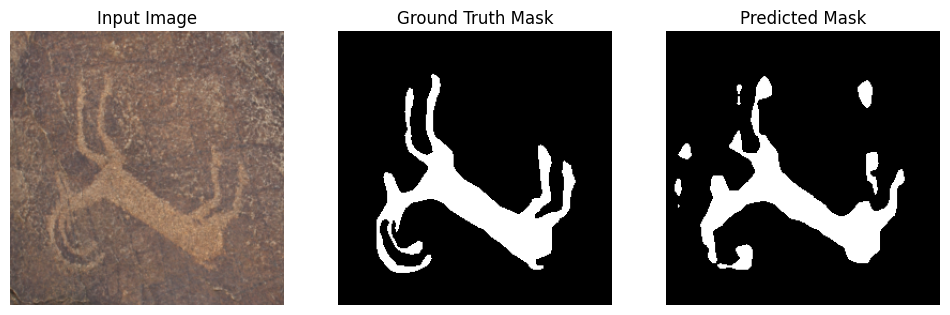

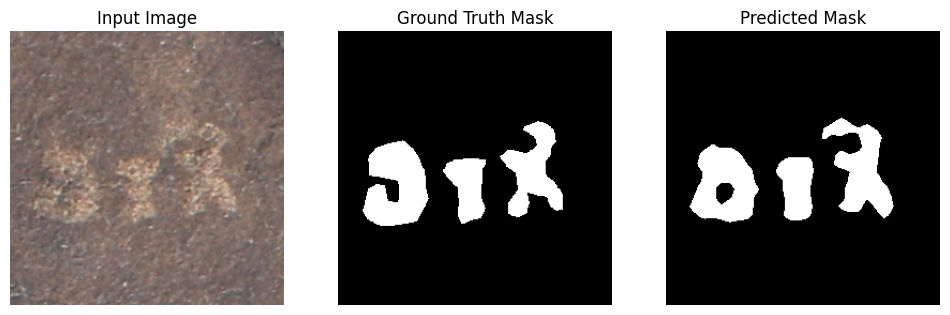

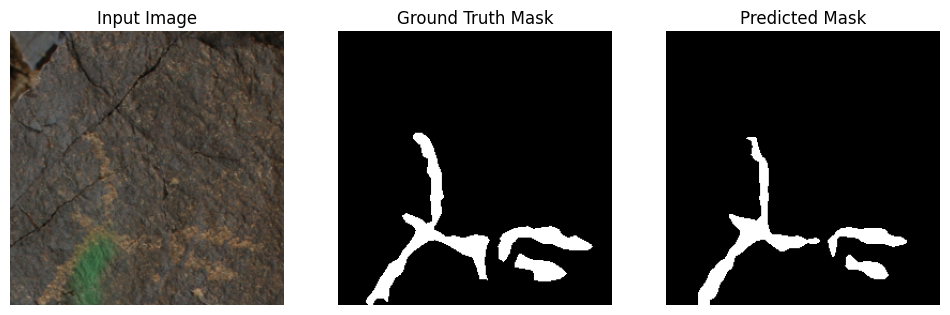

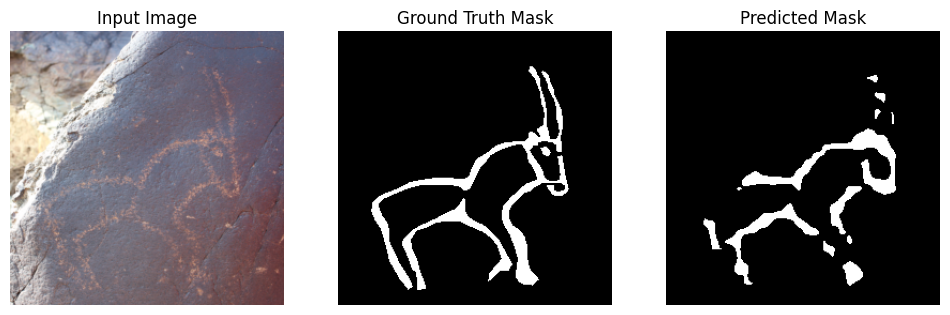

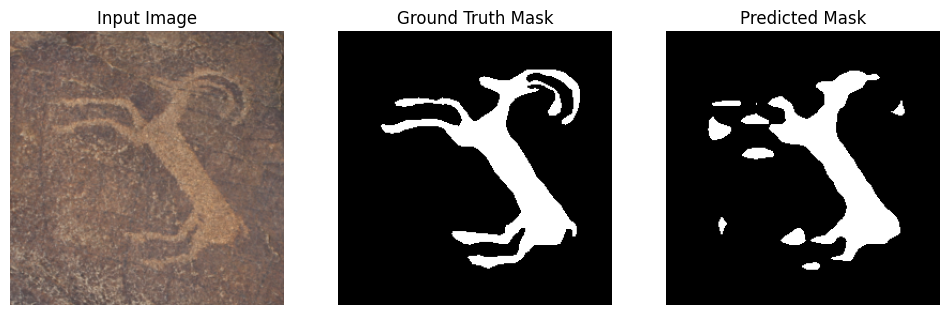

...

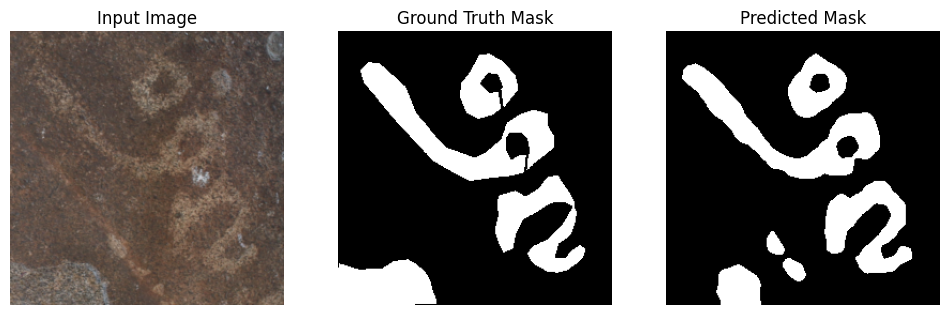

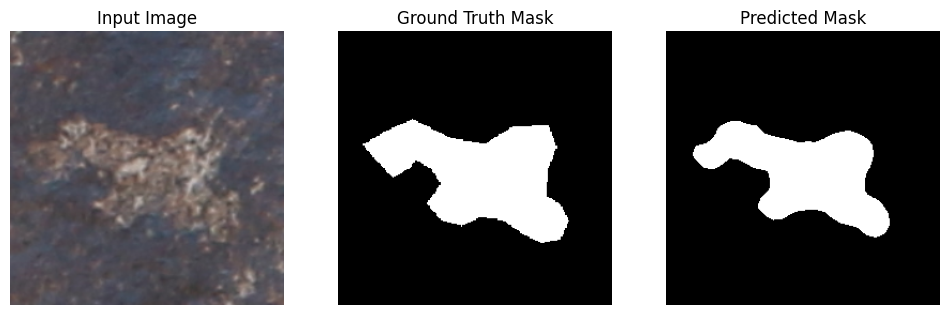

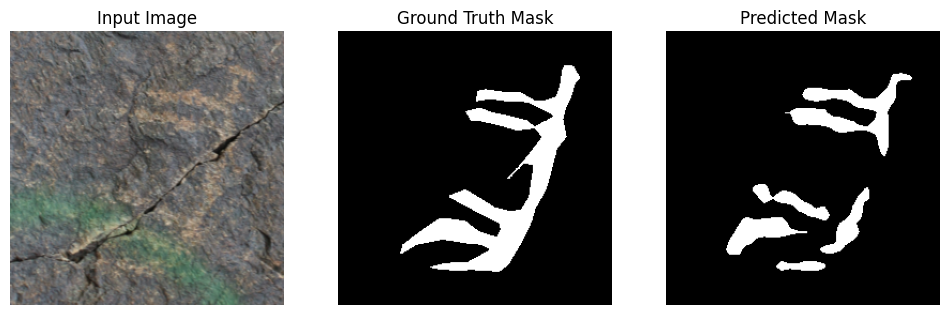

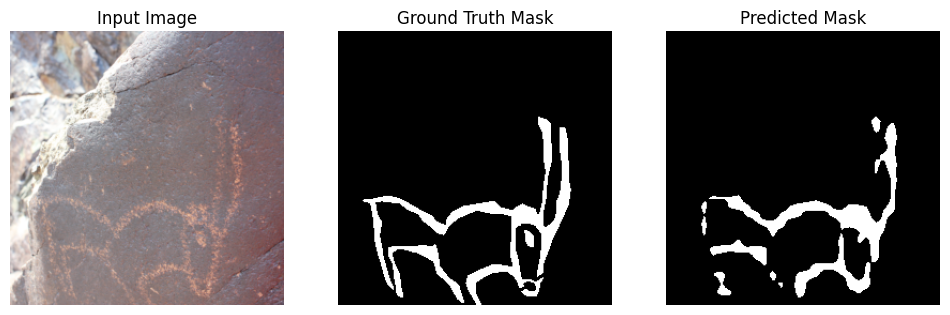

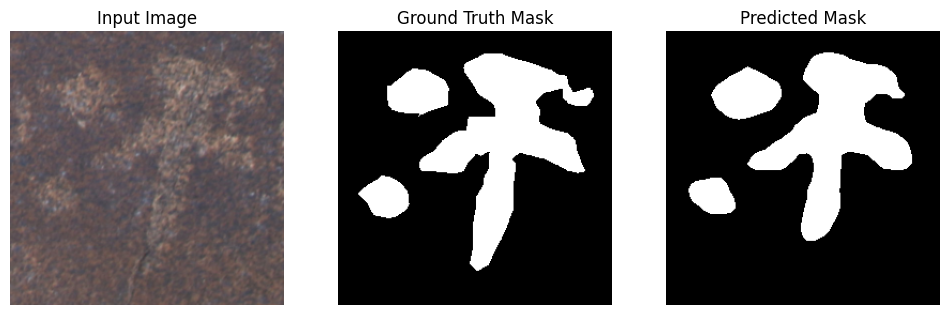

In [10]:
import matplotlib.pyplot as plt
import numpy as np

#evaluate
model.eval() 
with torch.no_grad():
    for inputs, labels in val_loader:
        inputs = inputs.to(device)
        labels = labels.to(device).squeeze(1).long()

        #forward pass
        outputs = model(inputs)['out']
        _, preds = torch.max(outputs, 1)

        #to numpy arrays for plotting
        inputs = inputs.cpu().numpy()
        labels = labels.cpu().numpy()
        preds = preds.cpu().numpy()

        #plot the images, ground truth, and predicted masks
        for i in range(min(3, inputs.shape[0])):
            img = np.transpose(inputs[i], (1, 2, 0))
            img = np.clip(img, 0, 1)

            #ground truth mask
            gt_mask = labels[i]

            #predicted mask
            pred_mask = preds[i]

            
            plt.figure(figsize=(12, 4))
            plt.subplot(1, 3, 1)
            plt.imshow(img)
            plt.title("Input Image")
            plt.axis('off')

            plt.subplot(1, 3, 2)
            plt.imshow(gt_mask, cmap='gray')
            plt.title("Ground Truth Mask")
            plt.axis('off')

            plt.subplot(1, 3, 3)
            plt.imshow(pred_mask, cmap='gray')
            plt.title("Predicted Mask")
            plt.axis('off')

            plt.show()

**Running model on images from roboflow to get predicted masks**

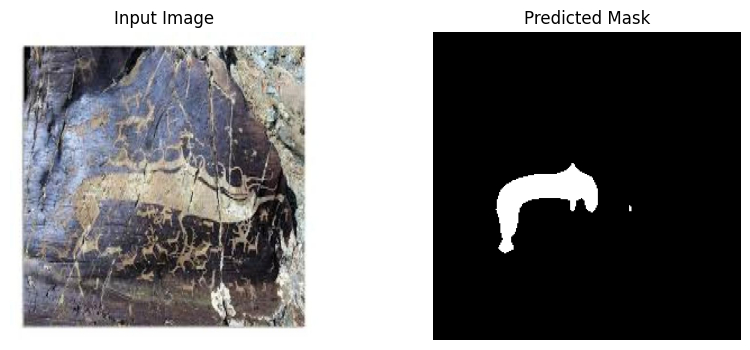

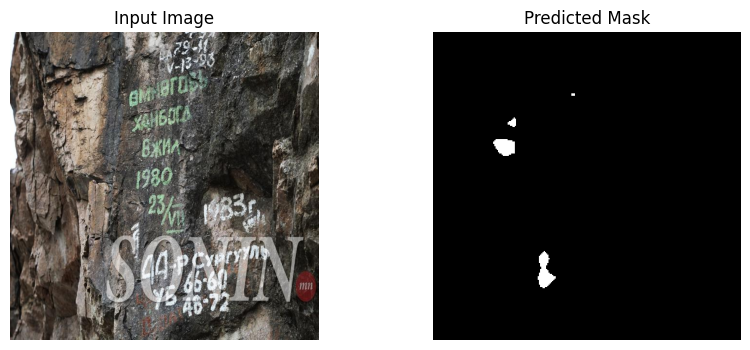

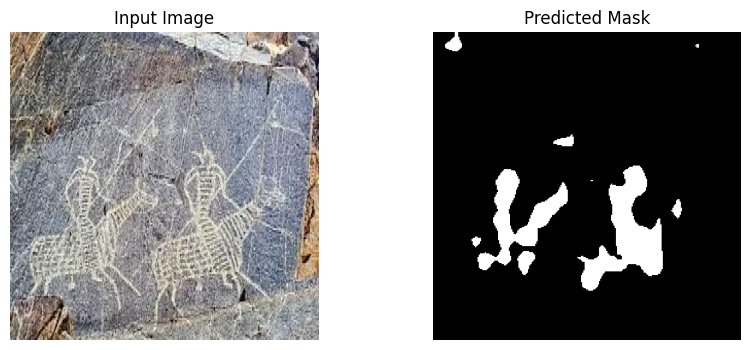

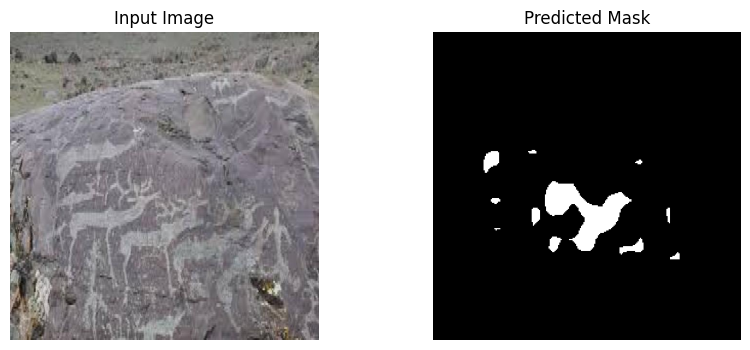

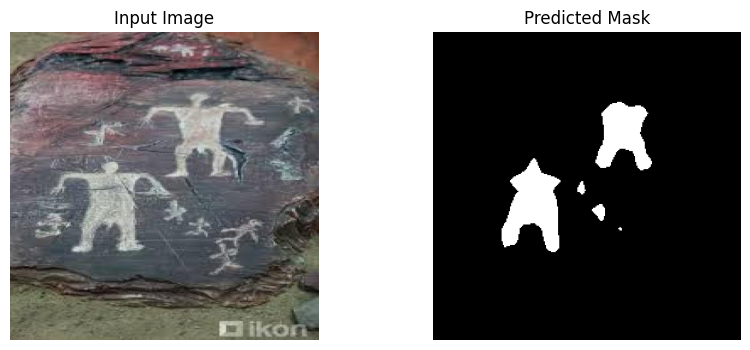

...

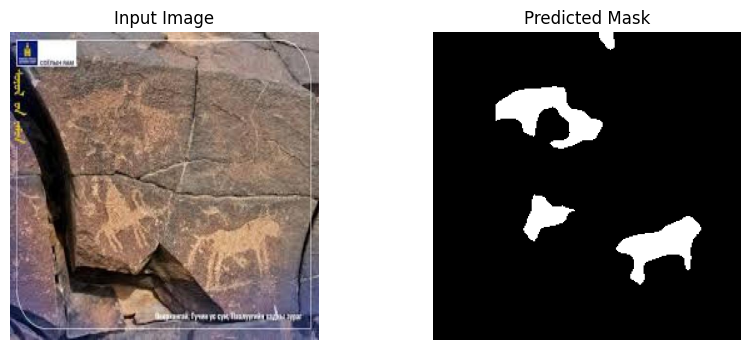

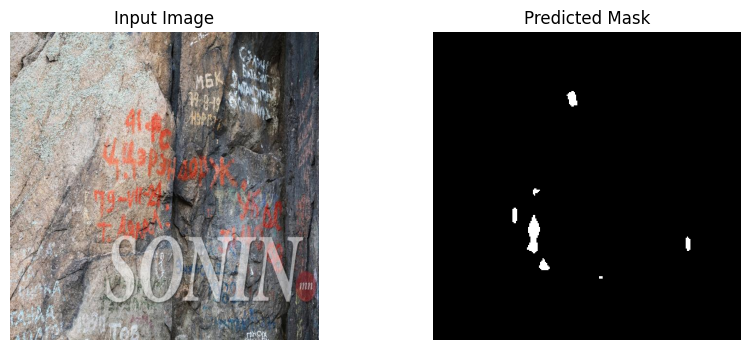

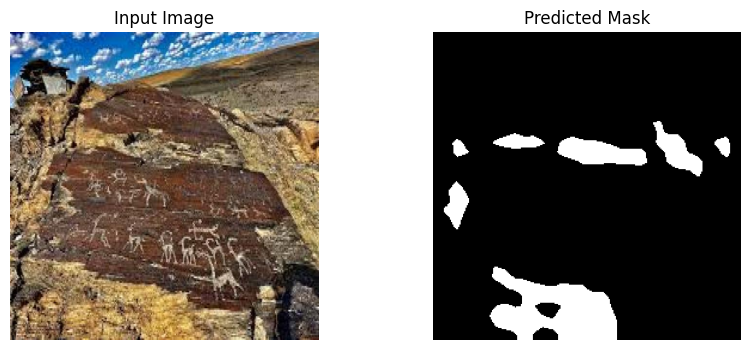

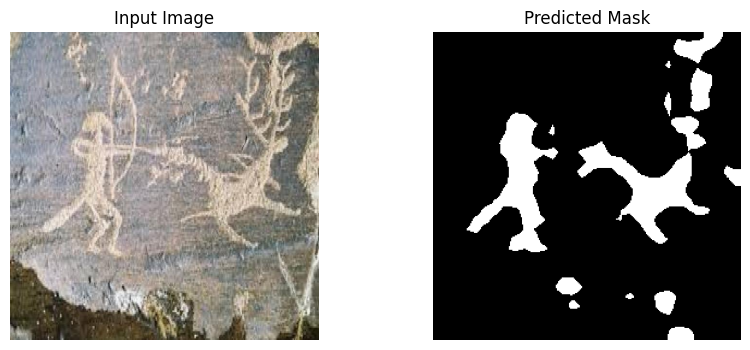

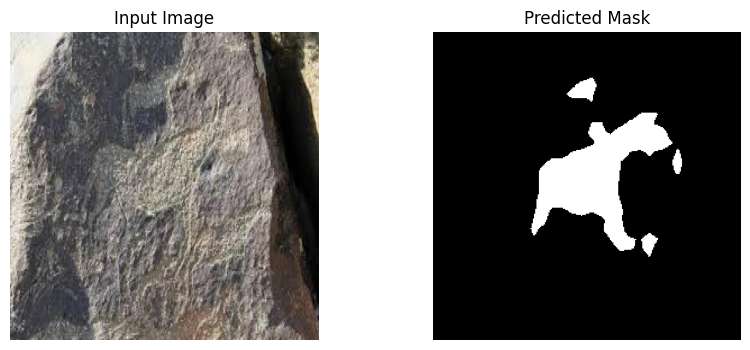

In [11]:
import os
import matplotlib.pyplot as plt

test_images_dir = '/kaggle/input/roboflow/images_roboflow'

os.makedirs('/kaggle/working/predicted_masks', exist_ok=True)

for fname in os.listdir(test_images_dir):
    if not fname.lower().endswith(('.png', '.jpg', '.jpeg')):
        continue

    img_path = os.path.join(test_images_dir, fname)
    image = Image.open(img_path).convert('RGB')
    input_tensor = transform(image).unsqueeze(0).to(device)

    with torch.no_grad():
        output = model(input_tensor)['out']
        pred_mask = torch.argmax(output.squeeze(), dim=0).cpu().numpy()

    mask_save_path = f'/kaggle/working/predicted_masks/{os.path.splitext(fname)[0]}_mask.png'
    Image.fromarray((pred_mask * 255).astype(np.uint8)).save(mask_save_path)

    plt.figure(figsize=(10, 4))
    plt.subplot(1, 2, 1)
    plt.imshow(image)
    plt.title('Input Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(pred_mask, cmap='gray')
    plt.title('Predicted Mask')
    plt.axis('off')

    plt.show()